In [102]:
import random
import matplotlib.pyplot as plt
import numpy as np

import plotly.graph_objects as go

In [103]:
#função para iterar com um passo decimal
def drange(start, stop, step):
     r = start
     while r < stop:
         yield r
         r += step

In [104]:
def funcao_objetivo(x):
    return (x-10)**2+1
def funcao_objetivo_seno(x):
    return np.sin(x)
def rosenbrock(args):
    x,y=args
    return (1 - x)**2 + 100*(y - x**2)**2

In [105]:
def busca_sequencial(tamanho_passo, limite_inferior, limite_superior):
    melhor_x=None
    melhor_y=None
    melhor_valor = np.inf

    melhores_dominios=[]
    melhores_imagens =[]
    dominio_x=[]
    dominio_y=[]
    imagem=[]

    for x in drange(limite_inferior,limite_superior+tamanho_passo, tamanho_passo):
        for y in drange(limite_inferior, limite_superior + tamanho_passo, tamanho_passo):
            valor = rosenbrock((x,y))
            if melhor_valor > valor:
                melhor_valor = valor
                melhor_x=x
                melhor_y=y

        melhores_dominios.append((melhor_x, melhor_y))
        melhores_imagens.append(melhor_valor)
        dominio_x.append(x)
        dominio_y.append(y)
        imagem.append(valor)

    return melhor_x,melhor_y,melhor_valor,dominio_x,dominio_y, imagem, melhores_dominios, melhores_imagens



In [106]:
import random
import numpy as np
import pandas as pd
import time

def funcao_rosenbrock(x, y, a=1, b=100):
    """
    Função de Rosenbrock para dois parâmetros.
    
    Parâmetros:
    x, y (float): Variáveis de entrada.
    a, b (float): Parâmetros da função de Rosenbrock.
    
    Retorna:
    float: Valor da função Rosenbrock para o par (x, y).
    """
    return (a - x)**2 + b * (y - x**2)**2

def busca_aleatoria(quantidade_iteracoes, limite_inferior, limite_superior):
    pontos_x = []
    pontos_y = []
    pontos_valor = []

    melhores_dominios=[]
    melhores_imagens =[]
    dominio_x=[]
    dominio_y=[]
    imagem=[]

    melhor_x = None
    melhor_y = None
    melhor_valor = np.inf
    pior_x = None
    pior_y = None
    pior_valor = -np.inf

    for _ in range(quantidade_iteracoes):
        x = random.uniform(limite_inferior, limite_superior)
        y = random.uniform(limite_inferior, limite_superior)
        valor = funcao_rosenbrock(x, y)

        pontos_x.append(x)
        pontos_y.append(y)
        pontos_valor.append(valor)

        # Atualiza o melhor valor e suas coordenadas
        if valor < melhor_valor:
            melhor_valor = valor
            melhor_x = x
            melhor_y = y

        # Atualiza o pior valor e suas coordenadas
        if valor > pior_valor:
            pior_valor = valor
            pior_x = x
            pior_y = y

        melhores_dominios.append((melhor_x, melhor_y))
        melhores_imagens.append(melhor_valor)

    return melhor_x,melhor_y, melhor_valor,pior_x, pior_y, pior_valor


# Parâmetros
quantidade_execucoes = 10
quantidade_iteracoes = 1000
limite_inferior = -5
limite_superior = 10

# Execução das buscas aleatórias e armazenamento dos resultados
resultados = []

for _ in range(quantidade_execucoes):
    inicio_tempo = time.time()
    melhor_x, melhor_y, melhor_valor, pior_x, pior_y, pior_valor = busca_aleatoria(quantidade_iteracoes, limite_inferior, limite_superior)
    fim_tempo = time.time()
    tempo_execucao = fim_tempo - inicio_tempo

    resultados.append({
        "Melhor Valor": melhor_valor,
        "Melhor X": melhor_x,
        "Melhor Y": melhor_y,
        "Pior Valor": pior_valor,
        "Pior X": pior_x,
        "Pior Y": pior_y,
        "Tempo de Execução (s)": tempo_execucao
    })

# Criação do DataFrame com os resultados
df_resultados = pd.DataFrame(resultados)

# Cálculo das estatísticas e dos valores mínimos e máximos
estatisticas = {
    "Estatísticas": ["Melhor Valor", "Pior Valor", "Média dos Valores", "Mediana dos Valores", "Desvio Padrão dos Valores", "Tempo Médio (s)", "Tempo Total (s)", 
                     "Melhor X", "Pior X", "Melhor Y", "Pior Y"],
    "Valores": [
        df_resultados["Melhor Valor"].min(),
        df_resultados["Pior Valor"].max(),
        df_resultados["Melhor Valor"].mean(),
        df_resultados["Melhor Valor"].median(),
        df_resultados["Melhor Valor"].std(),
        df_resultados["Tempo de Execução (s)"].mean(),
        df_resultados["Tempo de Execução (s)"].sum(),
        df_resultados["Melhor X"].min(),
        df_resultados["Pior X"].max(),
        df_resultados["Melhor Y"].min(),
        df_resultados["Pior Y"].max()
    ]
}

# Tabela final com estatísticas
df_estatisticas = pd.DataFrame(estatisticas)

# Exibindo os resultados
print("Resultados das 10 execuções:")
print(df_resultados)
print("\nEstatísticas gerais:")
print(df_estatisticas)



Resultados das 10 execuções:
   Melhor Valor  Melhor X  Melhor Y    Pior Valor    Pior X    Pior Y  \
0      2.438598 -0.302815  0.177794  1.057750e+06  9.987870 -3.085504   
1      0.028996  1.170117  1.369922  1.087329e+06  9.967625 -4.917667   
2      0.154008  1.329431  1.788714  1.091260e+06  9.981780 -4.823584   
3      0.328890  1.546600  2.374618  1.056721e+06  9.926703 -4.253611   
4      0.129663  0.650569  0.431935  1.067451e+06  9.979688 -3.719448   
5      0.636157  0.214911  0.032118  1.047429e+06  9.984907 -2.641695   
6      1.137779  1.041723  0.978602  9.901025e+05  9.751956 -4.399391   
7      0.147059  0.787104  0.651428  1.059393e+06  9.976606 -3.390225   
8      0.734675  0.842817  0.794600  1.020551e+06  9.818535 -4.614830   
9      0.204836  0.618907  0.407461  1.069560e+06  9.999247 -3.430659   

   Tempo de Execução (s)  
0               0.001998  
1               0.000998  
2               0.001993  
3               0.000998  
4               0.001995  
5    

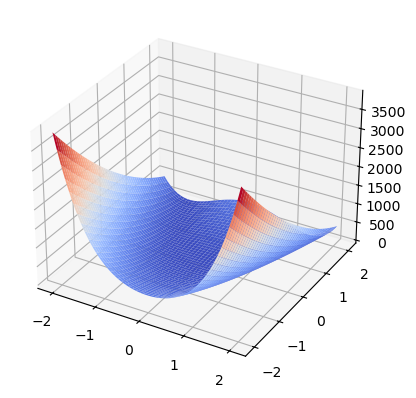

In [107]:
#Dados para plot do gráfico 3D
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

x1_v = np.linspace(-2.048,2.048,500)
x2_v = np.linspace(-2.048,2.048,500)
x1_arr, x2_arr = np.meshgrid(x1_v,x2_v)

f_arr = [[rosenbrock([x1_,x2_]) for x1_ in x1_v] for x2_ in x2_v]
f_arr = np.array(f_arr)

# ax=plt.figure().add_subplot(projection='3d')
surf =ax.plot_surface(x1_arr,x2_arr,f_arr,cmap=plt.cm.coolwarm)

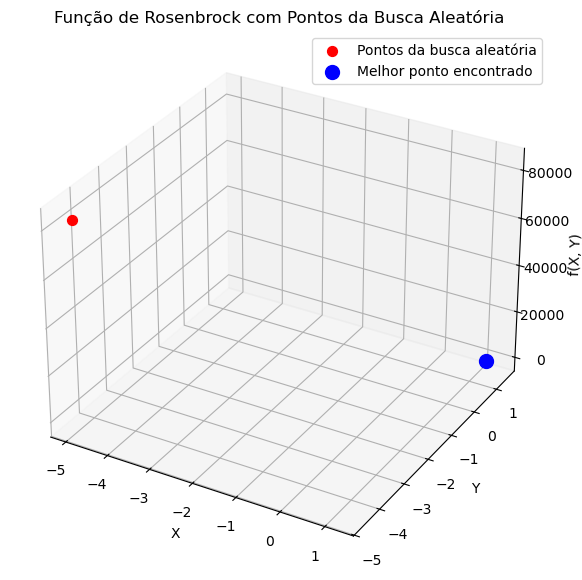

In [108]:
# Parâmetros
quantidade_iteracoes = 1000
limite_inferior = -5
limite_superior = 5

# Executa a busca aleatória e obtém os pontos
melhor_x, melhor_y, melhor_valor, pontos_x, pontos_y, pontos_valor = busca_aleatoria(
    quantidade_iteracoes, limite_inferior, limite_superior
)

# Criação da superfície 3D de Rosenbrock
# x = np.linspace(limite_inferior, limite_superior, 100)
# y = np.linspace(limite_inferior, limite_superior, 100)
# x, y = np.meshgrid(x, y)
# z = funcao_rosenbrock(x, y)

fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Plota todos os pontos encontrados na busca aleatória
ax.scatter(pontos_x, pontos_y, pontos_valor, color='red', s=50, label='Pontos da busca aleatória')

# Plota o melhor ponto encontrado
ax.scatter(melhor_x, melhor_y, melhor_valor, color='blue', s=100, label='Melhor ponto encontrado')

# Configurações de rótulos e título
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("f(X, Y)")
ax.set_title("Função de Rosenbrock com Pontos da Busca Aleatória")
ax.legend()

# Exibe o gráfico
plt.show()

In [109]:
# Cria os dados
x = np.linspace(-15.,15.,500)
y = np.linspace(-15.,15.,500)
x, y = np.meshgrid(x, y)
z = [[rosenbrock([x1_,x2_]) for x1_ in x1_v] for x2_ in x2_v]
z = np.array(z)


fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])

# Adiciona título e rótulos aos eixos
fig.update_layout(title='Superfície 3D', autosize=False,
                  width=500, height=500,
                  scene=dict(
                      xaxis=dict(title='Eixo X'),
                      yaxis=dict(title='Eixo Y'),
                      zaxis=dict(title='Eixo Z'),
                  ))

# Mostra o gráfico
fig.show()

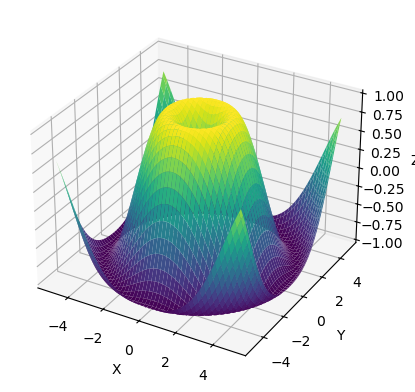

In [110]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Criação dos dados
x = np.linspace(-5, 5, 100)
y = np.linspace(-5, 5, 100)
x, y = np.meshgrid(x, y)
z = np.sin(np.sqrt(x**2 + y**2))

# Criação do gráfico 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
plot = ax.plot_surface(x, y, z, cmap='viridis')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

# Função para interatividade do mouse
def on_mouse_move(event):
    if event.inaxes == ax:
        ax.view_init(elev=ax.elev, azim=ax.azim)
        fig.canvas.draw_idle()

# Conectar a função de interatividade do mouse ao evento de movimento do mouse
fig.canvas.mpl_connect('motion_notify_event', on_mouse_move)

plt.show()


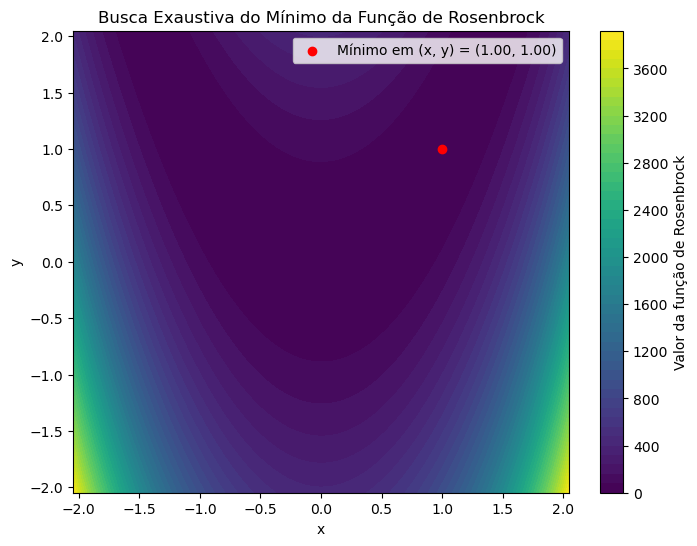

O mínimo da função ocorre em (x, y) = (0.9983743743743743, 0.9983743743743743)
O valor mínimo da função é f(x, y) = 0.00026605002977602083


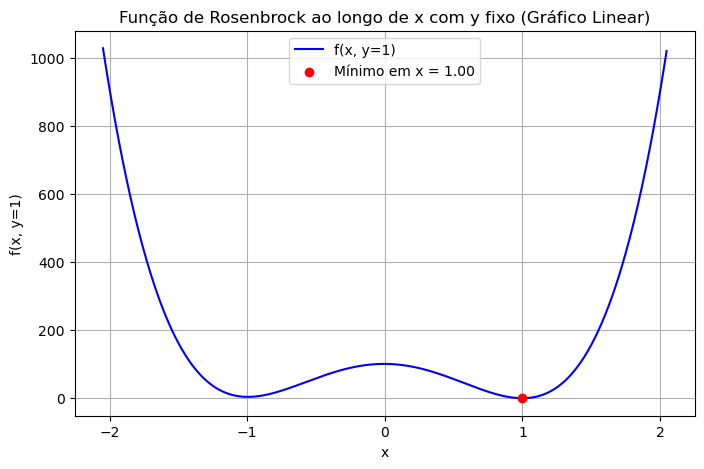

O mínimo da função ocorre em x = 0.9983743743743743
O valor mínimo da função é f(x, y=1) = 0.0010579884374510775


In [111]:

def funcao_rosenbrock(x, y, a=1, b=100):
    """
    Função de Rosenbrock.
    
    Parâmetros:
    x (float): Ponto no eixo x.
    y (float): Ponto no eixo y.
    a (float): Parâmetro da função de Rosenbrock (padrão é 1).
    b (float): Parâmetro da função de Rosenbrock (padrão é 100).
    
    Retorna:
    float: Valor da função de Rosenbrock para os pontos (x, y).
    """
    return (a - x)**2 + b * (y - x**2)**2


def busca_exaustiva(a, b, passos):
    """
    Realiza uma busca exaustiva para encontrar o mínimo de uma função f no intervalo [a, b].

    Parâmetros:
    f (callable): Função a ser minimizada.
    a (float): Limite inferior do intervalo.
    b (float): Limite superior do intervalo.
    passos (int): Número de pontos a serem avaliados no intervalo.

    Retorna:
    float: Ponto onde a função f tem o menor valor.
    float: Valor mínimo da função.
    """
    # Cria um vetor de pontos uniformemente espaçados no intervalo [a, b]
    x = np.linspace(a, b, passos)
    y = np.linspace(a, b, passos)
    x_grid, y_grid = np.meshgrid(x,y)

    # Avalia a função em cada ponto
    valores = funcao_rosenbrock(x_grid,y_grid)

    # Encontra o índice do valor mínimo
    idx_min = np.unravel_index(np.argmin(valores), valores.shape)
    ponto_minimo_x = x_grid[idx_min]
    ponto_minimo_y = y_grid[idx_min]
    valor_minimo = valores[idx_min]

    # Retorna o ponto de mínimo e o valor mínimo
    return (ponto_minimo_x, ponto_minimo_y), valor_minimo, x_grid, y_grid, valores

# Exemplo de uso
# Definindo uma função exemplo f(x) = (x - 2) ** 2

# Intervalo de busca [a, b] e número de passos
limite_inferior = -2.048
limite_superior = 2.048
passos = 1000

# Encontrando o mínimo
ponto_minimo, valor_minimo, x_grid, y_grid, valores = busca_exaustiva(
    limite_inferior, limite_superior, passos
)


# Plotando a função e o ponto de mínimo
plt.figure(figsize=(8, 6))
plt.contourf(x_grid, y_grid, valores, levels=50, cmap='viridis')
plt.colorbar(label='Valor da função de Rosenbrock')
plt.scatter(*ponto_minimo, color='red', label=f'Mínimo em (x, y) = ({ponto_minimo[0]:.2f}, {ponto_minimo[1]:.2f})')
plt.title('Busca Exaustiva do Mínimo da Função de Rosenbrock')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.show()

print(f'O mínimo da função ocorre em (x, y) = {ponto_minimo}')
print(f'O valor mínimo da função é f(x, y) = {valor_minimo}')

# Criação dos pontos no eixo x e avaliação da função com y fixo
x = np.linspace(limite_inferior, limite_superior, passos)
valores = funcao_rosenbrock(x, y=1)  # Mantendo y fixo em 1

# Encontrando o índice do valor mínimo
idx_min = np.argmin(valores)
ponto_minimo_x = x[idx_min]
valor_minimo = valores[idx_min]

# Plotando o gráfico linear
plt.figure(figsize=(8, 5))
plt.plot(x, valores, label='f(x, y=1)', color='blue')
plt.scatter(ponto_minimo_x, valor_minimo, color='red', label=f'Mínimo em x = {ponto_minimo_x:.2f}', zorder=5)
plt.title('Função de Rosenbrock ao longo de x com y fixo (Gráfico Linear)')
plt.xlabel('x')
plt.ylabel('f(x, y=1)')
plt.grid(True)
plt.legend()
plt.show()

print(f'O mínimo da função ocorre em x = {ponto_minimo_x}')
print(f'O valor mínimo da função é f(x, y=1) = {valor_minimo}')
